In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import seaborn as sns

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('fivethirtyeight')
matplotlib.rcParams['font.family'] = "Arial"

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly as py
import plotly.graph_objs as go
from plotly.subplots import make_subplots

init_notebook_mode(connected=True)

import collections
import itertools

import scipy.stats as stats
from scipy.stats import norm
from scipy.special import boxcox1p

import statsmodels
import statsmodels.api as sm
#print(statsmodels.__version__)

from sklearn.preprocessing import scale, StandardScaler, RobustScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, KFold, StratifiedKFold, RandomizedSearchCV
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV, LinearRegression, ElasticNet,  HuberRegressor
from sklearn.metrics import mean_squared_error, r2_score
from xgboost import XGBRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.svm import SVR
from sklearn.kernel_ridge import KernelRidge
from sklearn.utils import resample

from xgboost import XGBRegressor

#Model interpretation modules

# Explainbale AI (XAI)
!pip install lime
import lime.lime_tabular
!pip install shap
import shap

# Unsupervised Learning: Clustering
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, Birch, MeanShift, SpectralClustering
from sklearn.metrics import adjusted_rand_score

# AutoML
!pip install pycaret
from pycaret.regression import *

import lime
# import shap
# shap.initjs()

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

!pip install geopandas
# AutoML
!pip install pycaret
from pycaret.regression import *

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283839 sha256=7816e2b46572ae2568b0cb736dccbc795762bf90bb0d8754ecf6e20d1d8b8e87
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 8.6 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 483.6/483.6 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.0/150.0 kB 18.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━

In [2]:
import numpy as np
import pandas as pd

import os
import sklearn
import statsmodels.api as sm
import matplotlib.pyplot as plt
import matplotlib as mpl


from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNetCV
from sklearn.linear_model import ElasticNet

from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from numpy import mean

from sklearn.model_selection import RepeatedKFold, GridSearchCV, cross_val_score
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import MinMaxScaler, PolynomialFeatures

from sklearn.linear_model import Lasso, Ridge
from sklearn.linear_model import RidgeCV, LassoCV
from numpy import arange
import warnings 
warnings.filterwarnings('ignore')

from sklearn.tree import DecisionTreeRegressor 
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import AdaBoostClassifier
import xgboost as xgb
from sklearn import model_selection
from sklearn.ensemble import GradientBoostingClassifier
from sklearn import tree
from sklearn.pipeline import Pipeline

In [3]:
df_orig = pd.read_csv('/content/AB_NYC_2019.csv')
df = pd.read_csv('/content/AB_NYC_2019.csv')

In [4]:
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,19-10-18,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,21-05-19,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,05-07-19,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,19-11-18,0.10,1,0


In [4]:
df.shape

(48895, 16)

## Cleaning and Feature Engineering

In [5]:
number_null = df.isnull().sum()
percent_null = (df.isnull().sum() / len(df)) * 100
missing_data = pd.concat([number_null, percent_null], axis=1, keys=['Total Missing','Percent Missing'], sort=False)
missing_data

,Total Missing,Percent Missing
id,0,0.000000
name,16,0.032723
host_id,0,0.000000
host_name,21,0.042949
neighbourhood_group,0,0.000000
neighbourhood,0,0.000000
latitude,0,0.000000
longitude,0,0.000000
room_type,0,0.000000
price,0,0.000000


In [6]:
val_unique = df.nunique()
perc_unique = (df.nunique() / len(df)) * 100
unique_data = pd.concat([val_unique, perc_unique], axis=1, keys=['Total Unique','Percent Unique'], sort=False)
unique_data

,Total Unique,Percent Unique
id,48895,100.000000
name,47896,97.956846
host_id,37457,76.607015
host_name,11452,23.421618
neighbourhood_group,5,0.010226
neighbourhood,221,0.451989
latitude,19048,38.956949
longitude,14718,30.101237
room_type,3,0.006136
price,674,1.378464


In [7]:
df.dtypes

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [8]:
df.drop(['id', 'host_id', 'host_name','name'], axis=1, inplace=True)
df['last_review'] = pd.to_datetime(df['last_review'],infer_datetime_format=True) 

In [9]:
df[df['number_of_reviews']== 0.0].shape

(10052, 12)

The NaN values in the last_review and reviews_per_month columns all occur for examples where no reviews were given in the first place.
For reviews_per_month, I will fill those values with 0's.

In [10]:
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)

earliest = min(df['last_review'])
# This line finds the earliest date in the "last_review" column of the DataFrame df and stores it in the variable earliest. 
# The min function returns the minimum value of the "last_review" column.
df['last_review'] = df['last_review'].fillna(earliest)
# This line fills in missing values (i.e., NaN values) in the "last_review" column with the value stored in the earliest variable. 
# The fillna method replaces all NaN values in the "last_review" column with the value in earliest.

df['last_review'] = df['last_review'].apply(lambda x: x.toordinal() - earliest.toordinal())
# This line converts the date values in the "last_review" column to an ordinal representation 
# (i.e., a single integer representing the number of days since January 1, 1 AD). 
# The ordinal representation is calculated by subtracting the ordinal representation of the earliest date from each date in the "last_review" column. 
# The apply method applies the lambda function (i.e., the lambda x: x.toordinal() - earliest.toordinal() function) to 
# each value in the "last_review" column, and the result is stored back in the "last_review" column.

In [11]:
number_null = df.isnull().sum()
percent_null = (df.isnull().sum() / len(df)) * 100
missing_data = pd.concat([number_null, percent_null], axis=1, keys=['Total Missing','Percent Missing'], sort=False)
missing_data

,Total Missing,Percent Missing
neighbourhood_group,0,0.0
neighbourhood,0,0.0
latitude,0,0.0
longitude,0,0.0
room_type,0,0.0
price,0,0.0
minimum_nights,0,0.0
number_of_reviews,0,0.0
last_review,0,0.0
reviews_per_month,0,0.0


## EDA

In [13]:

import geopandas as gpd

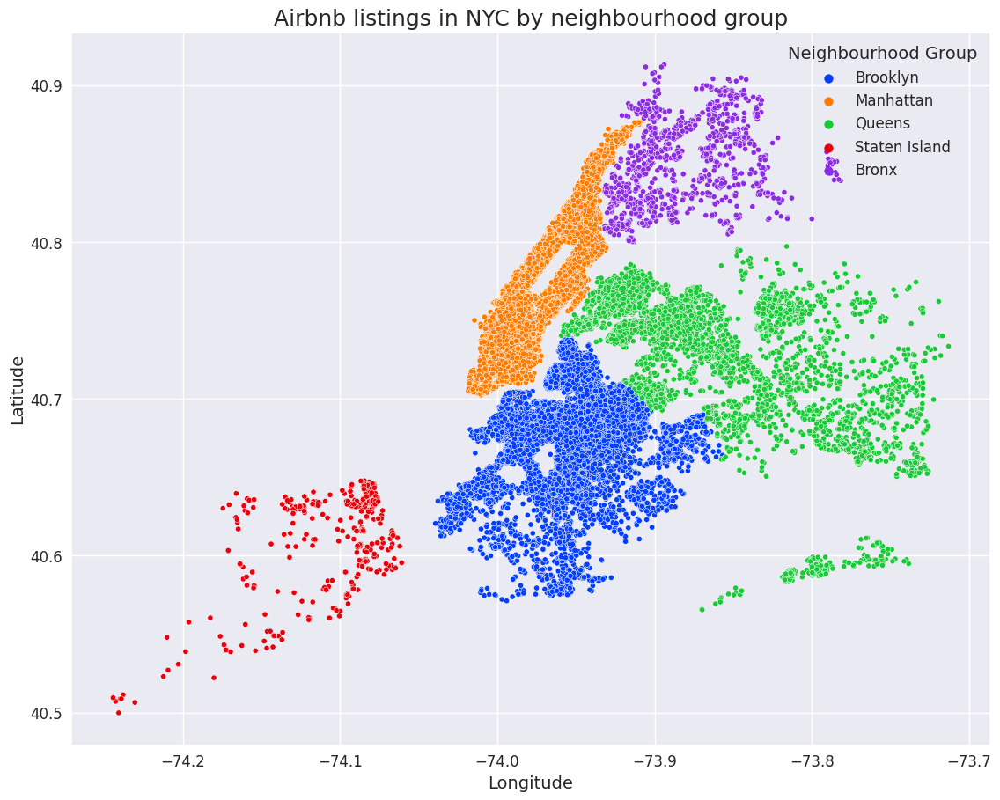

In [14]:

plt.figure(figsize=(12, 10))
sns.set_style("darkgrid")
sns.set_palette("bright")
sns.scatterplot(x='longitude', y='latitude', hue='neighbourhood_group', s=20, data=df)
plt.title('Airbnb listings in NYC by neighbourhood group', fontsize=18)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)
plt.tick_params(labelsize=12)
plt.legend(title='Neighbourhood Group', loc='upper right', fontsize=12, title_fontsize=14)
plt.show()

In [15]:
# from PIL import Image

# city_image = Image.open('New_York_City_.png')


### Price Distribution

Text(0, 0.5, 'Sample Quantiles')

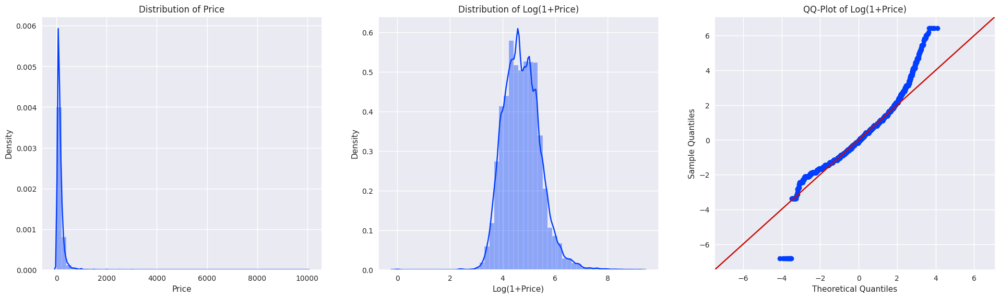

In [16]:

# Set figure size and subplots
fig, axes = plt.subplots(1, 3, figsize=(21, 6))

# Plot distribution of 'price' column in dataframe df
sns.distplot(df['price'], ax=axes[0])
axes[0].set_title('Distribution of Price')
axes[0].set_xlabel('Price')

# Plot distribution of log-transformed 'price' column in dataframe df
sns.distplot(np.log1p(df['price']), ax=axes[1])
axes[1].set_title('Distribution of Log(1+Price)')
axes[1].set_xlabel('Log(1+Price)')

# Plot QQ-plot of log-transformed 'price' column in dataframe df
sm.qqplot(np.log1p(df['price']), stats.norm, fit=True, line='45', ax=axes[2])
axes[2].set_title('QQ-Plot of Log(1+Price)')
axes[2].set_xlabel('Theoretical Quantiles')
axes[2].set_ylabel('Sample Quantiles')

In [12]:
df = df[np.log1p(df['price']) < 8]
df = df[np.log1p(df['price']) > 3]

Text(0, 0.5, 'Sample Quantiles')

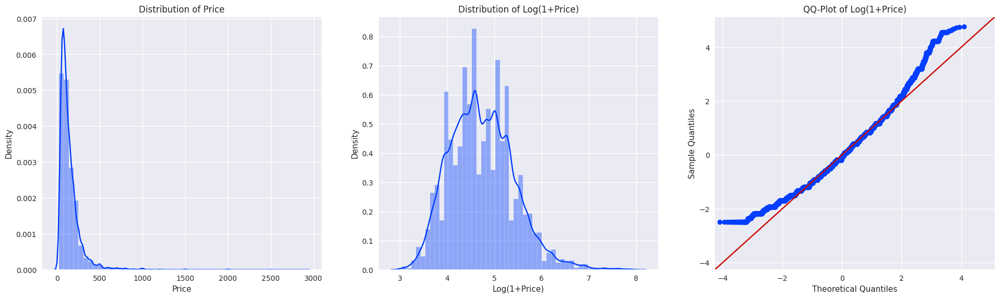

In [18]:

# Set figure size and subplots
fig, axes = plt.subplots(1, 3, figsize=(21, 6))

# Plot distribution of 'price' column in dataframe df
sns.distplot(df['price'], ax=axes[0])
axes[0].set_title('Distribution of Price')
axes[0].set_xlabel('Price')

# Plot distribution of log-transformed 'price' column in dataframe df
sns.distplot(np.log1p(df['price']), ax=axes[1])
axes[1].set_title('Distribution of Log(1+Price)')
axes[1].set_xlabel('Log(1+Price)')

# Plot QQ-plot of log-transformed 'price' column in dataframe df
sm.qqplot(np.log1p(df['price']), stats.norm, fit=True, line='45', ax=axes[2])
axes[2].set_title('QQ-Plot of Log(1+Price)')
axes[2].set_xlabel('Theoretical Quantiles')
axes[2].set_ylabel('Sample Quantiles')

In [13]:
df['price'] = np.log1p(df['price'])

In [20]:
df.columns

Index(['neighbourhood_group', 'neighbourhood', 'latitude', 'longitude',
       'room_type', 'price', 'minimum_nights', 'number_of_reviews',
       'last_review', 'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

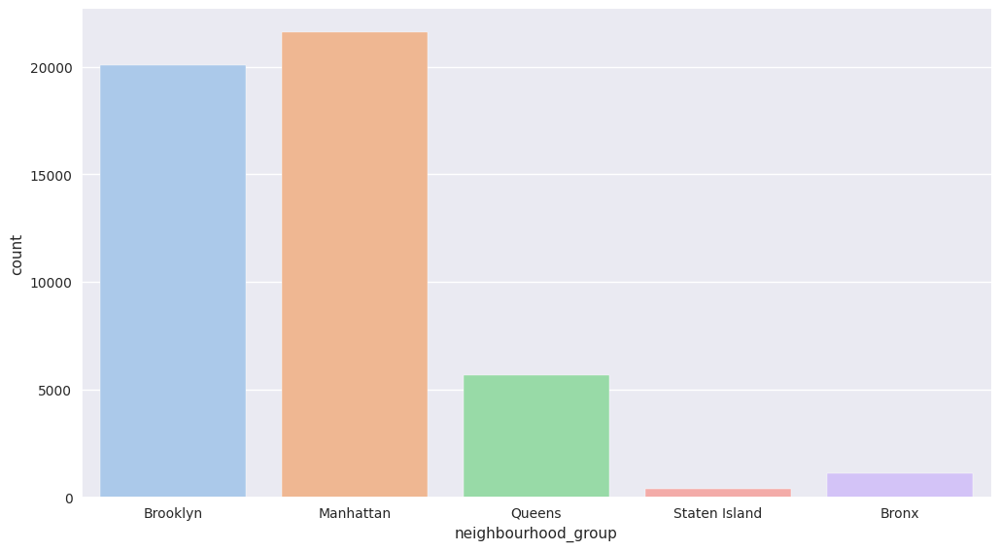

In [21]:
sns.catplot(x='neighbourhood_group', kind='count' ,data=df, palette="pastel")
fig = plt.gcf()
fig.set_size_inches(12, 6)

<Axes: xlabel='latitude', ylabel='longitude'>

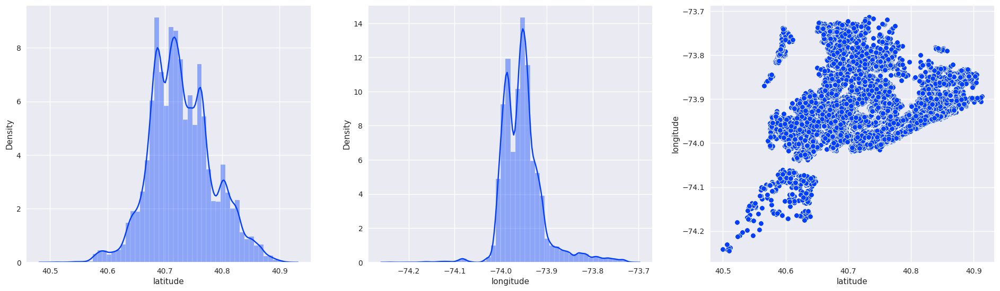

In [22]:
fig, axes = plt.subplots(1,3, figsize=(21,6))
sns.distplot(df['latitude'], ax=axes[0])
sns.distplot(df['longitude'], ax=axes[1])
sns.scatterplot(x= df['latitude'], y=df['longitude'])

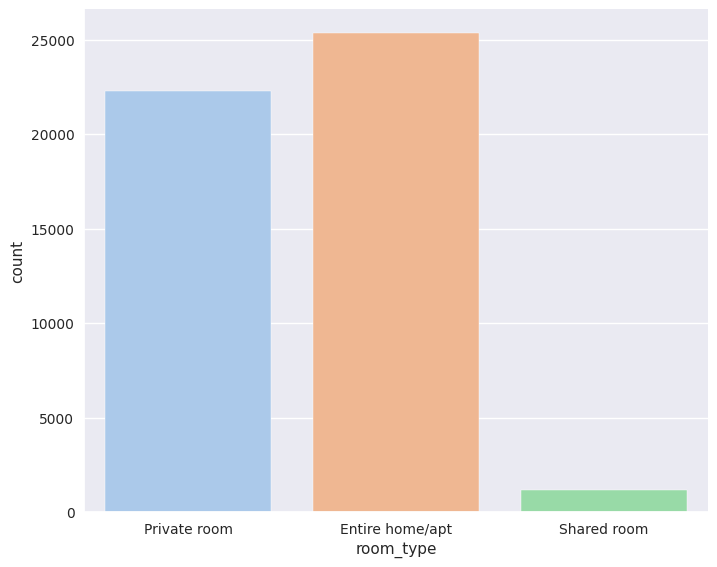

In [23]:
sns.catplot(x='room_type', kind='count' ,data=df, palette='pastel')
fig = plt.gcf()
fig.set_size_inches(8, 6)

Text(0, 0.5, 'count')

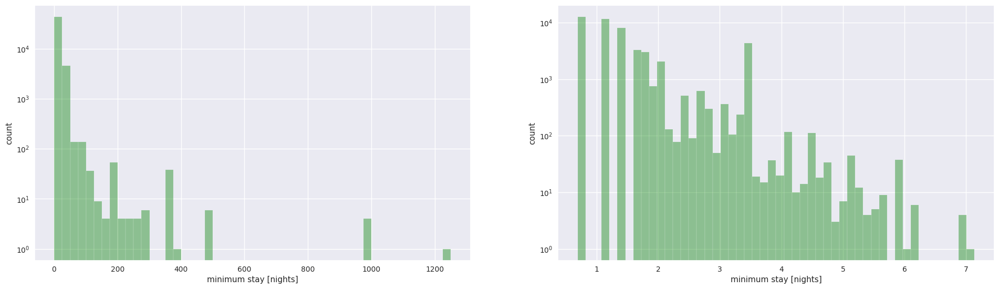

In [24]:
fig, axes = plt.subplots(1,2, figsize=(21, 6))

sns.distplot(df['minimum_nights'], rug=False, kde=False, color="green", ax = axes[0])
axes[0].set_yscale('log')
axes[0].set_xlabel('minimum stay [nights]')
axes[0].set_ylabel('count')

sns.distplot(np.log1p(df['minimum_nights']), rug=False, kde=False, color="green", ax = axes[1])
axes[1].set_yscale('log')
axes[1].set_xlabel('minimum stay [nights]')
axes[1].set_ylabel('count')

In [14]:
df['minimum_nights'] = np.log1p(df['minimum_nights'])

Text(0.5, 0, 'ln(reviews_per_month)')

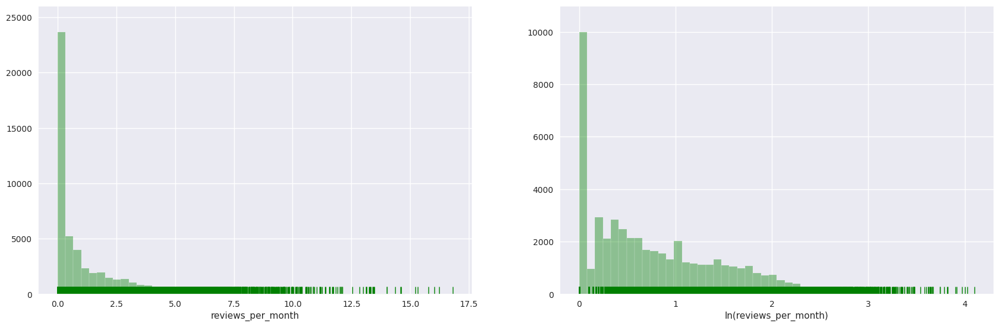

In [26]:
fig, axes = plt.subplots(1,2,figsize=(18.5, 6))
sns.distplot(df[df['reviews_per_month'] < 17.5]['reviews_per_month'], rug=True, kde=False, color="green", ax=axes[0])
sns.distplot(np.sqrt(df[df['reviews_per_month'] < 17.5]['reviews_per_month']), rug=True, kde=False, color="green", ax=axes[1])
axes[1].set_xlabel('ln(reviews_per_month)')

<Axes: xlabel='availability_365', ylabel='reviews_per_month'>

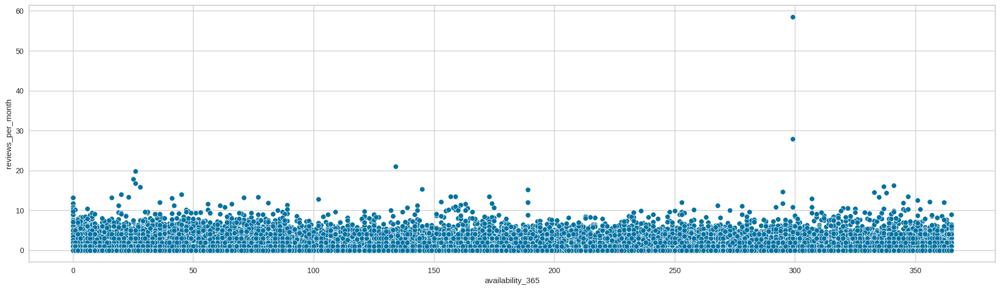

In [15]:
fig, axes = plt.subplots(1,1, figsize=(21,6))
sns.scatterplot(x= df['availability_365'], y=df['reviews_per_month'])

In [16]:
df['reviews_per_month'] = df[df['reviews_per_month'] < 17.5]['reviews_per_month']

(0.0, 365.0)

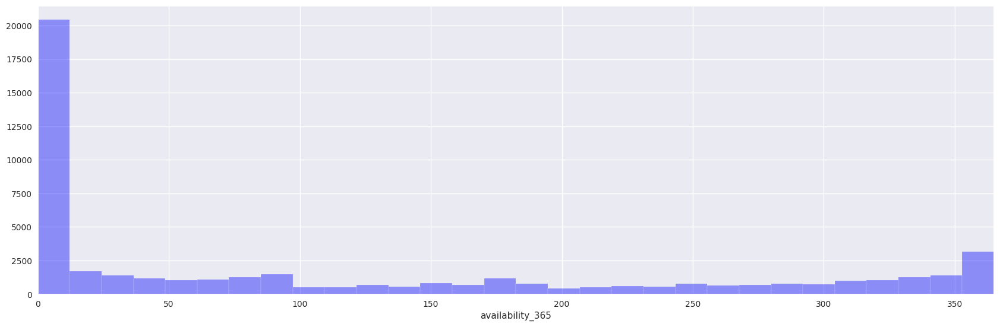

In [29]:
fig, axes = plt.subplots(1,1,figsize=(18.5, 6))
sns.distplot(df['availability_365'], rug=False, kde=False, color="blue", ax=axes)
axes.set_xlabel('availability_365')
axes.set_xlim(0, 365)

In [17]:
df['all_year_avail'] = df['availability_365']>353
df['low_avail'] = df['availability_365']< 12
df['no_reviews'] = df['reviews_per_month']==0

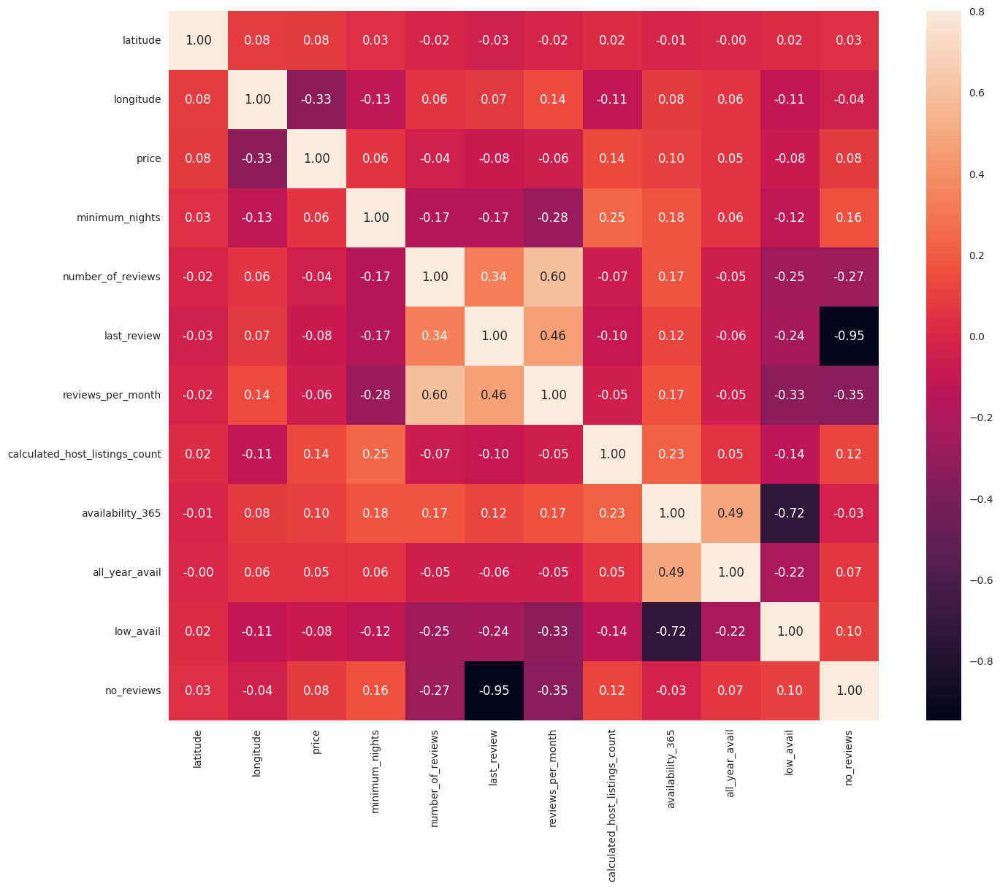

In [31]:
corrmatrix = df.corr()
f, ax = plt.subplots(figsize=(15,12))
sns.heatmap(corrmatrix, annot=True, fmt='.2f', vmax=0.8, square=True)
sns.set(font_scale=0.8)


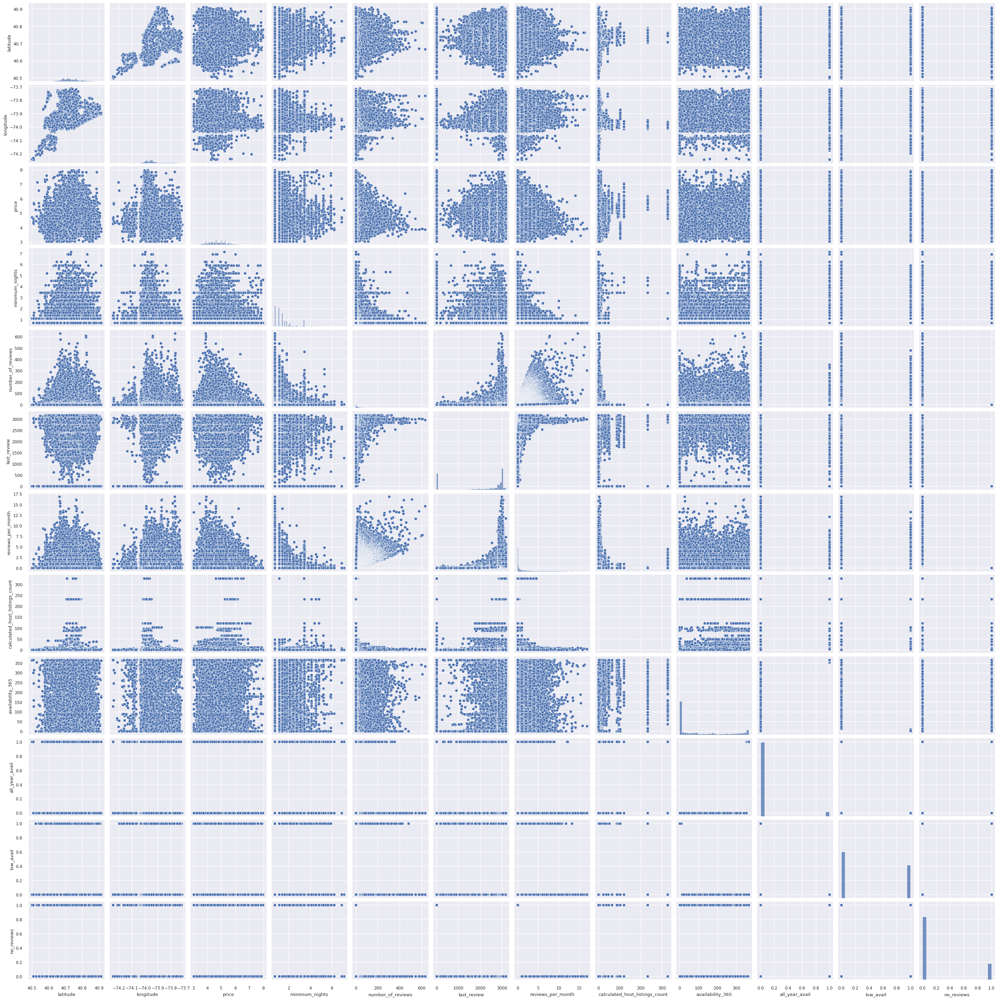

In [32]:
sns.pairplot(df.select_dtypes(exclude=['object']), palette='pastel')


In [18]:
categorical_features = df.select_dtypes(include=['object'])
print('Categorical features: {}'.format(categorical_features.shape))

Categorical features: (48784, 3)


In [20]:
categorical_features_one_hot = pd.get_dummies(categorical_features)
categorical_features_one_hot.head()

,neighbourhood_group_Bronx,neighbourhood_group_Brooklyn,neighbourhood_group_Manhattan,neighbourhood_group_Queens,neighbourhood_group_Staten Island,neighbourhood_Allerton,neighbourhood_Arden Heights,neighbourhood_Arrochar,neighbourhood_Arverne,neighbourhood_Astoria,...,neighbourhood_Williamsburg,neighbourhood_Willowbrook,neighbourhood_Windsor Terrace,neighbourhood_Woodhaven,neighbourhood_Woodlawn,neighbourhood_Woodrow,neighbourhood_Woodside,room_type_Entire home/apt,room_type_Private room,room_type_Shared room
0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
1,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
4,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [21]:
df.isnull().sum()

neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 5
calculated_host_listings_count    0
availability_365                  0
all_year_avail                    0
low_avail                         0
no_reviews                        0
dtype: int64

In [22]:
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)

In [23]:
numerical_features =  df.select_dtypes(exclude=['object'])
y = numerical_features.price
numerical_features = numerical_features.drop(['price'], axis=1)
print('Numerical features: {}'.format(numerical_features.shape))

Numerical features: (48784, 11)


In [24]:
X = np.concatenate((numerical_features, categorical_features_one_hot), axis=1)
X_df = pd.concat([numerical_features, categorical_features_one_hot], axis=1)

In [25]:
Processed_data = pd.concat([X_df, y], axis = 1)
Processed_data.to_csv('NYC_Airbnb_Processed.dat')

In [26]:
df_encoded = pd.concat([X_df, y], axis=1)

In [27]:
X_df.shape

(48784, 240)

In [42]:
import numpy as np
from sklearn.model_selection import train_test_split

# Assuming your dataframe is called 'df' and the target variable is called 'price'
X = df_encoded.drop('price', axis=1) # Features
y = df_encoded['price'] # Target variable

# Split the data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# Split the train data into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.05/0.85, random_state=42)

# Split the remaining 10% into a separate dataframe for deployment
X_deploy, _, y_deploy, _ = train_test_split(X_test, y_test, test_size=0.1, random_state=42)

# Verify the proportions
print(f"Train proportion: {len(X_train)/len(X):.2%}")
print(f"Validation proportion: {len(X_val)/len(X):.2%}")
print(f"Test proportion: {len(X_test)/len(X):.2%}")
print(f"Deploy proportion: {len(X_deploy)/len(X):.2%}")


Train proportion: 84.70%
Validation proportion: 5.29%
Test proportion: 10.00%
Deploy proportion: 9.00%


In [43]:
Rscaler = RobustScaler()

X_train_r = Rscaler.fit_transform(X_train)
X_val_r = Rscaler.transform(X_val)
X_test_r = Rscaler.transform(X_test)
X_deploy_r = Rscaler.transform(X_deploy)

Sscaler = StandardScaler()

X_train_s = Sscaler.fit_transform(X_train)
X_test_s = Sscaler.transform(X_test)
X_val_s = Sscaler.transform(X_val)
X_deploy_s = Sscaler.transform(X_deploy)

In [44]:
n_folds = 5

# squared_loss
def rmse_cv_r(model):
    kf = KFold(n_folds, shuffle=True, random_state = 91).get_n_splits(numerical_features)
    return cross_val_score(model, X_train_r, y_train, scoring='neg_mean_squared_error', cv=kf)

def rmse_cv_s(model):
    kf = KFold(n_folds, shuffle=True, random_state = 91).get_n_splits(numerical_features)
    return cross_val_score(model, X_train_s, y_train, scoring='neg_mean_squared_error', cv=kf)

In [45]:
for Model in [LinearRegression, Ridge, Lasso, ElasticNet, RandomForestRegressor, XGBRegressor, HuberRegressor]:
    if Model == XGBRegressor: cv_res = rmse_cv_r(XGBRegressor(objective='reg:squarederror'))
    else: cv_res = rmse_cv_r(Model())
    print('{}: {:.5f} +/- {:5f}'.format(Model.__name__, -cv_res.mean(), cv_res.std()))

LinearRegression: 346035436892912.12500 +/- 631764853426647.375000
Ridge: 0.19304 +/- 0.003191
Lasso: 0.45152 +/- 0.002665
ElasticNet: 0.45081 +/- 0.002578
RandomForestRegressor: 0.17596 +/- 0.003675
XGBRegressor: 0.17386 +/- 0.002826
HuberRegressor: 0.20492 +/- 0.005376


In [46]:
for Model in [LinearRegression, Ridge, Lasso, ElasticNet, RandomForestRegressor, XGBRegressor]:
    if Model == XGBRegressor: cv_res = rmse_cv_s(XGBRegressor(objective='reg:squarederror'))
    else: cv_res = rmse_cv_s(Model())
    print('{}: {:.5f} +/- {:5f}'.format(Model.__name__, -cv_res.mean(), cv_res.std()))

LinearRegression: 1734353315715969422721024.00000 +/- 1904266151541921172946944.000000
Ridge: 0.19338 +/- 0.002994
Lasso: 0.45868 +/- 0.003121
ElasticNet: 0.45868 +/- 0.003121
RandomForestRegressor: 0.17617 +/- 0.003449
XGBRegressor: 0.17382 +/- 0.002767


In [47]:
X_train_s = pd.DataFrame(X_train_s, columns=X_train.columns)

In [48]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score

# Define the XGBRegressor model
model = XGBRegressor()


# Define the KFold cross-validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# List to store the r2 scores
r2_scores = []

# Loop through each cross-validation fold
for train_idx, test_idx in kf.split(X_train_s):
    X_train1, y_train1 = X_train_s.iloc[train_idx], y.iloc[train_idx]
    X_test1, y_test1 = X_train_s.iloc[test_idx], y.iloc[test_idx]
    
    # Fit the XGBRegressor model to the training data
    model.fit(X_train1, y_train1)
    
    # Predict the target variable on the test data
    y_pred1 = model.predict(X_test1)
    
    # Calculate r2 score
    r2 = r2_score(y_test1, y_pred1)
    
    # Append r2 score to the list
    r2_scores.append(r2)

# Calculate the average r2 score across all folds
avg_r2_score = sum(r2_scores) / len(r2_scores)

print("r2 scores:", r2_scores)
print("Average r2 score:", avg_r2_score)


r2 scores: [-0.037144722159469845, -0.043860175915658495, -0.027303277690762018, -0.029202139121270676, -0.03681140824865725]
Average r2 score: -0.03486434462716366


In [49]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score

# Define the XGBRegressor model
model = LinearRegression()


# Define the KFold cross-validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# List to store the r2 scores
r2_scores = []

# Loop through each cross-validation fold
for train_idx, test_idx in kf.split(X_train_s):
    X_train1, y_train1 = X_train_s.iloc[train_idx], y.iloc[train_idx]
    X_test1, y_test1 = X_train_s.iloc[test_idx], y.iloc[test_idx]
    
    # Fit the XGBRegressor model to the training data
    model.fit(X_train1, y_train1)
    
    # Predict the target variable on the test data
    y_pred1 = model.predict(X_test1)
    
    # Calculate r2 score
    r2 = r2_score(y_test1, y_pred1)
    
    # Append r2 score to the list
    r2_scores.append(r2)

# Calculate the average r2 score across all folds
avg_r2_score = sum(r2_scores) / len(r2_scores)

print("r2 scores:", r2_scores)
print("Average r2 score:", avg_r2_score)


r2 scores: [-5.117273338547359e+25, -3.2118440724031025e+25, -7.338609093633118e+23, -4.55303718654612e+24, -2.1289947304377044e+27]
Average r2 score: -4.435145605286237e+26


In [50]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score
from sklearn.linear_model import Ridge

# Define the XGBRegressor model
model = Ridge()


# Define the KFold cross-validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# List to store the r2 scores
r2_scores = []

# Loop through each cross-validation fold
for train_idx, test_idx in kf.split(X_train_s):
    X_train1, y_train1 = X_train_s.iloc[train_idx], y.iloc[train_idx]
    X_test1, y_test1 = X_train_s.iloc[test_idx], y.iloc[test_idx]
    
    # Fit the XGBRegressor model to the training data
    model.fit(X_train1, y_train1)
    
    # Predict the target variable on the test data
    y_pred1 = model.predict(X_test1)
    
    # Calculate r2 score
    r2 = r2_score(y_test1, y_pred1)
    
    # Append r2 score to the list
    r2_scores.append(r2)

# Calculate the average r2 score across all folds
avg_r2_score = sum(r2_scores) / len(r2_scores)

print("r2 scores:", r2_scores)
print("Average r2 score:", avg_r2_score)


r2 scores: [-0.00574919097169202, -0.008086363629714155, -0.006020682512763331, -0.01031060630941516, -0.006840666137115425]
Average r2 score: -0.0074015019121400185


In [51]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score
from sklearn.linear_model import Lasso

# Define the XGBRegressor model
model = Lasso()


# Define the KFold cross-validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# List to store the r2 scores
r2_scores = []

# Loop through each cross-validation fold
for train_idx, test_idx in kf.split(X_train_s):
    X_train1, y_train1 = X_train_s.iloc[train_idx], y.iloc[train_idx]
    X_test1, y_test1 = X_train_s.iloc[test_idx], y.iloc[test_idx]
    
    # Fit the XGBRegressor model to the training data
    model.fit(X_train1, y_train1)
    
    # Predict the target variable on the test data
    y_pred1 = model.predict(X_test1)
    
    # Calculate r2 score
    r2 = r2_score(y_test1, y_pred1)
    
    # Append r2 score to the list
    r2_scores.append(r2)

# Calculate the average r2 score across all folds
avg_r2_score = sum(r2_scores) / len(r2_scores)

print("r2 scores:", r2_scores)
print("Average r2 score:", avg_r2_score)


r2 scores: [-8.737995406105092e-05, -7.816759111434202e-05, -4.243262215530841e-05, -9.743178651211437e-06, -0.00010039282480578393]
Average r2 score: -6.362323415753934e-05


In [52]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score
from sklearn.linear_model import Lasso

# Define the XGBRegressor model
model = ElasticNet()


# Define the KFold cross-validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# List to store the r2 scores
r2_scores = []

# Loop through each cross-validation fold
for train_idx, test_idx in kf.split(X_train_s):
    X_train1, y_train1 = X_train_s.iloc[train_idx], y.iloc[train_idx]
    X_test1, y_test1 = X_train_s.iloc[test_idx], y.iloc[test_idx]
    
    # Fit the XGBRegressor model to the training data
    model.fit(X_train1, y_train1)
    
    # Predict the target variable on the test data
    y_pred1 = model.predict(X_test1)
    
    # Calculate r2 score
    r2 = r2_score(y_test1, y_pred1)
    
    # Append r2 score to the list
    r2_scores.append(r2)

# Calculate the average r2 score across all folds
avg_r2_score = sum(r2_scores) / len(r2_scores)

print("r2 scores:", r2_scores)
print("Average r2 score:", avg_r2_score)


r2 scores: [-8.737995406105092e-05, -7.816759111434202e-05, -4.243262215530841e-05, -9.743178651211437e-06, -0.00010039282480578393]
Average r2 score: -6.362323415753934e-05


In [53]:
from xgboost import XGBRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score
from sklearn.linear_model import Lasso

# Define the XGBRegressor model
model = RandomForestRegressor()


# Define the KFold cross-validator
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# List to store the r2 scores
r2_scores = []

# Loop through each cross-validation fold
for train_idx, test_idx in kf.split(X_train_s):
    X_train1, y_train1 = X_train_s.iloc[train_idx], y.iloc[train_idx]
    X_test1, y_test1 = X_train_s.iloc[test_idx], y.iloc[test_idx]
    
    # Fit the XGBRegressor model to the training data
    model.fit(X_train1, y_train1)
    
    # Predict the target variable on the test data
    y_pred1 = model.predict(X_test1)
    
    # Calculate r2 score
    r2 = r2_score(y_test1, y_pred1)
    
    # Append r2 score to the list
    r2_scores.append(r2)

# Calculate the average r2 score across all folds
avg_r2_score = sum(r2_scores) / len(r2_scores)

print("r2 scores:", r2_scores)
print("Average r2 score:", avg_r2_score)


r2 scores: [-0.06333888965751466, -0.05700658264628, -0.05458892769997914, -0.059930681801769525, -0.05464619916505775]
Average r2 score: -0.05790225619412022


In [54]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_r, y_train)
ridge_model.fit(X_train_r, y_train)
Lasso_model.fit(X_train_r, y_train)
en_model.fit(X_train_r, y_train)
rf_model.fit(X_train_r, y_train)
xgb_model.fit(X_train_r, y_train)

y_pred_lin_r = lr_model.predict(X_val_r)
print('linear r:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r)
print('ridge r:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r)
print('lasso r:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r)
print('elastic net r:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r)
print('randomforest r:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r)
print('xgb r:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear r: 0.43500427428180677
ridge r: 0.4346108208307634
lasso r: 0.6724420567105368
elastic net r: 0.6718649573448198
randomforest r: 0.4183441740499073
xgb r: 0.4120362040701081


In [55]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_s, y_train)
ridge_model.fit(X_train_s, y_train)
Lasso_model.fit(X_train_s, y_train)
en_model.fit(X_train_s, y_train)
rf_model.fit(X_train_s, y_train)
xgb_model.fit(X_train_s, y_train)

y_pred_lin_r = lr_model.predict(X_val_r)
print('linear s:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r)
print('ridge s:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r)
print('lasso s:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r)
print('elastic net s:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r)
print('randomforest s:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear s: 5666857890801.589
ridge s: 0.6467829239822482
lasso s: 0.6787572375106184
elastic net s: 0.6787572375106184
randomforest s: 0.5146659238284258
xgb s: 0.5440981369891925


In [56]:
# alpha = 0.02, 0.05, 0.1, 0.5, 1, 1.5, 2, 5
# Create a Lasso model
lasso = Lasso(alpha=0.02)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_lpo2 = X_train_r[:, selected_features]
X_val_r_lpo2 = X_val_r[:, selected_features]
##################################################################
lasso = Lasso(alpha=0.05)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_lpo5 = X_train_r[:, selected_features]
X_val_r_lpo5 = X_val_r[:, selected_features]
##################################################################
lasso = Lasso(alpha=0.1)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_lp1 = X_train_r[:, selected_features]
X_val_r_lp1 = X_val_r[:, selected_features]
##################################################################
lasso = Lasso(alpha=0.5)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_lp5 = X_train_r[:, selected_features]
X_val_r_lp5 = X_val_r[:, selected_features]
##################################################################
lasso = Lasso(alpha=1)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_l1 = X_train_r[:, selected_features]
X_val_r_l1 = X_val_r[:, selected_features]
##################################################################
lasso = Lasso(alpha=2)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_l2 = X_train_r[:, selected_features]
X_val_r_l2 = X_val_r[:, selected_features]
##################################################################
lasso = Lasso(alpha=5)

# Fit the Lasso model to the data
lasso.fit(X_train_r, y_train)

# Get the selected features
selected_features = lasso.coef_ != 0

# Create a new dataset with the selected features
X_train_r_l5 = X_train_r[:, selected_features]
X_val_r_l5 = X_val_r[:, selected_features]


In [57]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_r_lpo2, y_train)
ridge_model.fit(X_train_r_lpo2, y_train)
Lasso_model.fit(X_train_r_lpo2, y_train)
en_model.fit(X_train_r_lpo2, y_train)
rf_model.fit(X_train_r_lpo2, y_train)
xgb_model.fit(X_train_r_lpo2, y_train)

y_pred_lin_r = lr_model.predict(X_val_r_lpo2)
print('linear s:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r_lpo2)
print('ridge s:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r_lpo2)
print('lasso s:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r_lpo2)
print('elastic net s:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r_lpo2)
print('randomforest s:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r_lpo2)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear s: 0.4724958337620216
ridge s: 0.4724965559176432
lasso s: 0.6724420567105368
elastic net s: 0.6718649573448198
randomforest s: 0.44768305146856324
xgb s: 0.4366038468338377


In [58]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_r_lpo5, y_train)
ridge_model.fit(X_train_r_lpo5, y_train)
Lasso_model.fit(X_train_r_lpo5, y_train)
en_model.fit(X_train_r_lpo5, y_train)
rf_model.fit(X_train_r_lpo5, y_train)
xgb_model.fit(X_train_r_lpo5, y_train)

y_pred_lin_r = lr_model.predict(X_val_r_lpo5)
print('linear s:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r_lpo5)
print('ridge s:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r_lpo5)
print('lasso s:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r_lpo5)
print('elastic net s:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r_lpo5)
print('randomforest s:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r_lpo5)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear s: 0.4880573682441021
ridge s: 0.48805781251218583
lasso s: 0.6724420567105368
elastic net s: 0.6718649573448198
randomforest s: 0.5338793649247161
xgb s: 0.46319430238550935


In [59]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_r_lp1, y_train)
ridge_model.fit(X_train_r_lp1, y_train)
Lasso_model.fit(X_train_r_lp1, y_train)
en_model.fit(X_train_r_lp1, y_train)
rf_model.fit(X_train_r_lp1, y_train)
xgb_model.fit(X_train_r_lp1, y_train)

y_pred_lin_r = lr_model.predict(X_val_r_lp1)
print('linear s:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r_lp1)
print('ridge s:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r_lp1)
print('lasso s:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r_lp1)
print('elastic net s:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r_lp1)
print('randomforest s:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r_lp1)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear s: 0.5018293516179527
ridge s: 0.50182991588266
lasso s: 0.6724420567105368
elastic net s: 0.6718649573448198
randomforest s: 0.5517873738444954
xgb s: 0.47820385732749127


In [60]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_r_lp5, y_train)
ridge_model.fit(X_train_r_lp5, y_train)
Lasso_model.fit(X_train_r_lp5, y_train)
en_model.fit(X_train_r_lp5, y_train)
rf_model.fit(X_train_r_lp5, y_train)
xgb_model.fit(X_train_r_lp5, y_train)

y_pred_lin_r = lr_model.predict(X_val_r_lp5)
print('linear s:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r_lp5)
print('ridge s:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r_lp5)
print('lasso s:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r_lp5)
print('elastic net s:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r_lp5)
print('randomforest s:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r_lp5)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear s: 0.6717267651788618
ridge s: 0.6717267651677161
lasso s: 0.6724420567105368
elastic net s: 0.6718649573448198
randomforest s: 0.6452058647281217
xgb s: 0.6451572983587283


In [61]:
lr_model = LinearRegression()
ridge_model = Ridge()
Lasso_model = Lasso()
en_model = ElasticNet()
rf_model = RandomForestRegressor()
xgb_model = XGBRegressor()

lr_model.fit(X_train_r_l1, y_train)
ridge_model.fit(X_train_r_l1, y_train)
Lasso_model.fit(X_train_r_l1, y_train)
en_model.fit(X_train_r_l1, y_train)
rf_model.fit(X_train_r_l1, y_train)
xgb_model.fit(X_train_r_l1, y_train)

y_pred_lin_r = lr_model.predict(X_val_r_l1)
print('linear s:', np.sqrt(mean_squared_error(y_val, y_pred_lin_r)) )

y_pred_ridge_r = ridge_model.predict(X_val_r_l1)
print('ridge s:', np.sqrt(mean_squared_error(y_val, y_pred_ridge_r)) )

y_pred_lasso_r = Lasso_model.predict(X_val_r_l1)
print('lasso s:', np.sqrt(mean_squared_error(y_val, y_pred_lasso_r)) )

y_pred_en_r = en_model.predict(X_val_r_l1)
print('elastic net s:', np.sqrt(mean_squared_error(y_val, y_pred_en_r)) )

y_pred_rf_r = rf_model.predict(X_val_r_l1)
print('randomforest s:', np.sqrt(mean_squared_error(y_val, y_pred_rf_r)) )

y_pred_xgb_r = xgb_model.predict(X_val_r_l1)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb_r)) )

linear s: 0.6717267651788618
ridge s: 0.6717267651677161
lasso s: 0.6724420567105368
elastic net s: 0.6718649573448198
randomforest s: 0.6451907426466925
xgb s: 0.6451572983587283


In [62]:

# Create a Lasso model
lasso = Lasso()

# Define the grid of hyperparameters to search
param_grid = {'alpha': [0.05, 0.1, 0.3, 1, 3, 5, 10, 15, 30, 50, 75] }

# Create a grid search object
grid_search = GridSearchCV(lasso, param_grid, cv=5, scoring='neg_mean_squared_error')

# Perform grid search on the data
grid_search.fit(X_train_r, y_train)

# Print the best hyperparameters and score
print("Best alpha: {:.4f}".format(grid_search.best_params_['alpha']))
print("Best score: {:.2f}".format(-grid_search.best_score_))
print("RMSE:", np.sqrt(-grid_search.best_score_))

Best alpha: 0.0500
Best score: 0.26
RMSE: 0.5102903634706819


In [63]:

# Create a Lasso model
ridge = Ridge()

# Define the grid of hyperparameters to search
param_grid = {'alpha': [0.05, 0.1, 0.3, 1, 3, 5, 10, 15, 30, 50, 75] }

# Create a grid search object
grid_search = GridSearchCV(ridge, param_grid, cv=5, scoring='neg_mean_squared_error')

# Perform grid search on the data
grid_search.fit(X_train_r, y_train)

# Print the best hyperparameters and score
print("Best alpha: {:.4f}".format(grid_search.best_params_['alpha']))
print("Best score: {:.2f}".format(-grid_search.best_score_))
print("RMSE:", np.sqrt(-grid_search.best_score_))

Best alpha: 3.0000
Best score: 0.19
RMSE: 0.4393490526380218


In [64]:
!pip install optuna
import optuna



# Define the objective function to optimize
def objective(trial):
    params = {
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse',
        'booster': 'gbtree',
        'n_estimators': trial.suggest_int('n_estimators', 50, 1000, step=50),
        'max_depth': trial.suggest_int('max_depth', 1, 10),
        'learning_rate': trial.suggest_loguniform('learning_rate', 0.001, 0.1),
        'subsample': trial.suggest_discrete_uniform('subsample', 0.5, 1, 0.1),
        'colsample_bytree': trial.suggest_discrete_uniform('colsample_bytree', 0.5, 1, 0.1),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-8, 100.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-8, 100.0),
        'random_state': 42,
        'n_jobs': -1
    }

    # Train and evaluate the model using the current set of hyperparameters
    model = XGBRegressor(**params)
    model.fit(X_train_r, y_train, eval_set=[(X_val_r, y_val)], early_stopping_rounds=10, verbose=False)
    y_pred = model.predict(X_val)
    rmse = mean_squared_error(y_val, y_pred, squared=False)
    return rmse

# Perform the hyperparameter search using Optuna
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=30)

# Print the best set of hyperparameters and corresponding RMSE
best_params = study.best_params
best_rmse = study.best_value
print("Best hyperparameters:", best_params)
print("Best RMSE: {:.2f}".format(best_rmse))


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.7/365.7 kB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 10.5 MB/s eta 0:00:00


[I 2023-05-27 08:23:07,935] A new study created in memory with name: no-name-3aa2afcc-8c78-419d-9472-fd193824dc19
[I 2023-05-27 08:24:37,932] Trial 0 finished with value: 0.7248489033890082 and parameters: {'n_estimators': 900, 'max_depth': 5, 'learning_rate': 0.03459863779817112, 'subsample': 0.6, 'colsample_bytree': 0.8, 'reg_alpha': 1.5236190008125694, 'reg_lambda': 2.4026446671130524}. Best is trial 0 with value: 0.7248489033890082.
[I 2023-05-27 08:26:18,328] Trial 1 finished with value: 1.0127741361736666 and parameters: {'n_estimators': 650, 'max_depth': 8, 'learning_rate': 0.0025290568196890844, 'subsample': 0.9, 'colsample_bytree': 0.6, 'reg_alpha': 26.500880878871655, 'reg_lambda': 40.03501873537876}. Best is trial 0 with value: 0.7248489033890082.
[I 2023-05-27 08:28:34,616] Trial 2 finished with value: 0.6742201044516175 and parameters: {'n_estimators': 650, 'max_depth': 8, 'learning_rate': 0.0044750379387379245, 'subsample': 1.0, 'colsample_bytree': 0.6, 'reg_alpha': 2.136

Best hyperparameters: {'n_estimators': 700, 'max_depth': 6, 'learning_rate': 0.0051656847610495145, 'subsample': 0.8, 'colsample_bytree': 0.5, 'reg_alpha': 1.6825075755549833e-08, 'reg_lambda': 0.8362432439357353}
Best RMSE: 0.59


In [65]:
# linear
# lasso
# ridge
# knn
# RF
# GB
# XGB
# LightGBM


# xgb_model = XGBRegressor(n_estimators=500, 
#                      max_depth=4, 
#                      learning_rate=0.0069548471258457055, 
#                      subsample=0.7, 
#                      colsample_bytree=0.5, 
#                      reg_alpha=9.868623389749522e-06, 
#                      reg_lambda=0.0008797024652026549)

xgb_model = XGBRegressor(n_estimators=1000, 
                     max_depth=1, 
                     learning_rate=0.09802634063280677, 
                     subsample=0.7, 
                     colsample_bytree=0.5, 
                     reg_alpha=5.482344607459488e-06, 
                     reg_lambda=4.1129533855985915e-06)


xgb_model.fit(X_train_r, y_train)
y_pred_xgb = xgb_model.predict(X_val_r)
print('xgb s:', np.sqrt(mean_squared_error(y_val, y_pred_xgb)) )

xgb s: 0.4292242796870614


In [66]:
X_train_r = pd.DataFrame(X_train_r)
y_train = pd.DataFrame(y_train)
X_val_r = pd.DataFrame(X_val_r)
y_val = pd.DataFrame(y_val)
X_test_r = pd.DataFrame(X_test_r)
y_test = pd.DataFrame(y_test)
X_deploy_r = pd.DataFrame(X_deploy_r)
y_deploy = pd.DataFrame(y_deploy)

X_train_r.to_csv('X_train_r', index=False)
y_train.to_csv('y_train', index=False)

X_val_r.to_csv('X_val_r', index=False)
y_val.to_csv('y_val', index=False)

X_test_r.to_csv('X_test_r', index=False)
y_test.to_csv('y_test', index=False)

X_deploy_r.to_csv('X_deploy_r', index=False)
y_deploy.to_csv('y_deploy', index=False)

In [67]:
# AutoML
# !pip install pycaret
# from pycaret.regression import *

py = setup(df, target = 'price',  ignore_features = ['id'])
best_model = compare_models(fold=3)

,Description,Value
0,Session id,4732
1,Target,price
2,Target type,Regression
3,Original data shape,"(48784, 15)"
4,Transformed data shape,"(48784, 56)"
5,Transformed train set shape,"(34148, 56)"
6,Transformed test set shape,"(14636, 56)"
7,Ignore features,1
8,Numeric features,8
9,Categorical features,3


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,0.3074,0.1784,0.4224,0.6090,0.0711,0.0645,14.4233
gbr,Gradient Boosting Regressor,0.3129,0.1813,0.4258,0.6026,0.0715,0.0655,4.9567
et,Extra Trees Regressor,0.3145,0.1886,0.4342,0.5867,0.0731,0.0660,8.0867
lr,Linear Regression,0.3258,0.1938,0.4403,0.5752,0.0741,0.0683,2.7867
ridge,Ridge Regression,0.3258,0.1938,0.4403,0.5752,0.0741,0.0683,0.6867
br,Bayesian Ridge,0.3258,0.1939,0.4403,0.5752,0.0741,0.0683,0.8400
huber,Huber Regressor,0.3608,0.2382,0.4879,0.4780,0.0830,0.0758,0.7733
omp,Orthogonal Matching Pursuit,0.3901,0.2667,0.5165,0.4154,0.0881,0.0828,0.4333
ada,AdaBoost Regressor,0.4363,0.3001,0.5459,0.3418,0.0944,0.0962,1.8700
dt,Decision Tree Regressor,0.4306,0.3480,0.5899,0.2374,0.0991,0.0904,0.8800


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

In [68]:
py = setup(df_orig, target = 'price',  ignore_features = ['id'])
best_model = compare_models(fold=3)

,Description,Value
0,Session id,5632
1,Target,price
2,Target type,Regression
3,Original data shape,"(48895, 16)"
4,Transformed data shape,"(48895, 56)"
5,Transformed train set shape,"(34226, 56)"
6,Transformed test set shape,"(14669, 56)"
7,Ignore features,1
8,Numeric features,8
9,Categorical features,6


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,89.4821,58226.6784,240.3549,0.0061,0.7394,0.8551,8.5833
rf,Random Forest Regressor,90.4634,58426.9571,240.7867,0.0024,0.7464,0.8695,14.7967
gbr,Gradient Boosting Regressor,90.8087,58465.4491,240.8799,0.0015,0.7492,0.8760,6.5533
lr,Linear Regression,90.8701,58503.3336,240.9589,0.0009,0.7509,0.8761,1.3833
ridge,Ridge Regression,90.8700,58503.2979,240.9589,0.0009,0.7509,0.8761,0.7533
en,Elastic Net,90.8722,58502.7937,240.9576,0.0009,0.7509,0.8763,0.7967
br,Bayesian Ridge,90.8687,58502.9831,240.9582,0.0009,0.7509,0.8761,0.7267
llar,Lasso Least Angle Regression,90.8916,58511.9153,240.9765,0.0007,0.7511,0.8765,0.6733
lasso,Lasso Regression,90.8916,58511.9154,240.9765,0.0007,0.7511,0.8765,0.7767
omp,Orthogonal Matching Pursuit,90.8972,58515.3289,240.9838,0.0006,0.7512,0.8766,0.6767


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

In [69]:
print(df.head())

  neighbourhood_group neighbourhood  latitude  longitude        room_type  \
0            Brooklyn    Kensington  40.64749  -73.97237     Private room   
1           Manhattan       Midtown  40.75362  -73.98377  Entire home/apt   
2           Manhattan        Harlem  40.80902  -73.94190     Private room   
3            Brooklyn  Clinton Hill  40.68514  -73.95976  Entire home/apt   
4           Manhattan   East Harlem  40.79851  -73.94399  Entire home/apt   

      price  minimum_nights  number_of_reviews  last_review  \
0  5.010635        0.693147                  9         2762   
1  5.420535        0.693147                 45         2976   
2  5.017280        1.386294                  0            0   
3  4.499810        0.693147                270         2962   
4  4.394449        2.397895                  9         2793   

   reviews_per_month  calculated_host_listings_count  availability_365  \
0               0.21                               6               365   
1         

# Performing Dummy Labeling and then Train_Test_Split

In [70]:
# PERFORMING ONE HOT ENCODING (DUMMY VARIABLE)
df_dummy = pd.get_dummies(df, drop_first=True)
print(df_dummy.shape)

X = df_dummy.loc[:, df_dummy.columns != 'price']
y = df_dummy[['price']]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

(48784, 238)


# Linear Regression

In [71]:
reg = LinearRegression().fit(X_train, y_train)
y_pred_test = reg.predict(X_test)

print("Mean squared error: %.2f" % mean_squared_error(y_test, y_pred_test))
print("Coefficient of determination: %.3f" % r2_score(y_test, y_pred_test))

Mean squared error: 0.20
Coefficient of determination: 0.573


# Random Forest

In [72]:

regRF = RandomForestRegressor(max_depth=10, max_features=30, min_samples_split=10,n_estimators=300, random_state=1)
regRF.fit(X_train, y_train)
print(regRF.score(X_test, y_test))


0.561587273758877


**Applying GridCV to find the Optimized Hyper-Parameter for Random  Forrest Regression**

In [73]:
# param_grid = {
#     'n_estimators': [100, 200, 300],
#     'max_depth': [None, 5, 10],
#     'min_samples_split': [2, 5, 10],
#     'min_samples_leaf': [1, 2, 4],
#     'max_features': ['auto', 'sqrt']
# }

# grid_search = GridSearchCV(RandomForestRegressor(), param_grid, cv=5)
# grid_search.fit(X_train, y_train)

# random_search = RandomizedSearchCV(RandomForestRegressor(), param_distributions=param_grid, n_iter=10, cv=5)
# random_search.fit(X_train, y_train)

# best_params = grid_search.best_params_  # or random_search.best_params_

# final_model = RandomForestRegressor(**best_params)
# final_model.fit(X_train, y_train)
# print(final_model.score(X_test, y_test))

# Gradient Boosting

In [74]:
regGB = GradientBoostingRegressor(max_depth=10, max_features=20, min_samples_split=10, n_estimators=300, random_state=0)
regGB.fit(X_train, y_train)
y_pred = regGB.predict(X_test)
print("GB: R2 = %.4f and MSE = %.2f" % (regGB.score(X_test,y_test), mean_squared_error(y_test, y_pred)))

GB: R2 = 0.6247 and MSE = 0.17


# Taking Gradient Boosting Multiple Times and then Taking Average

In [75]:


# pred_list = []
# for i in range(0, 25):
#     print(f'Value of i={i}')
#     regGB = GradientBoostingRegressor(max_depth=10, max_features=20, min_samples_split=10, n_estimators=300, random_state=None)
#     regGB.fit(X_train, y_train)
#     y_pred = regGB.predict(X_test)
#     print("GB: R2 = %.4f and MSE = %.2f" % (regGB.score(X_test,y_test), mean_squared_error(y_test, y_pred)))
#     pred_list.append(y_pred)

# sum_lst = sum(pred_list)

# lst_avg = sum_lst/len(pred_list)
# print('\n\nFINAL SCORE: ')
# print("GB: R2 = %.4f and MSE = %.2f" % (regGB.score(X_test,y_test), mean_squared_error(y_test, lst_avg)))

# Taking Gradient Boosting after Scaling the Input Dataset

In [76]:
scaler = MinMaxScaler(feature_range=(0, 1))
X_Scaled = scaler.fit_transform(X_train)
XS = pd.DataFrame(X_Scaled)
XS.columns = X.columns

regGB = GradientBoostingRegressor(max_depth=10, max_features=20, min_samples_split=10, n_estimators=300, random_state=0)
regGB.fit(XS, y_train)
y_pred = regGB.predict(X_test)
print("GB: R2 = %.4f and MSE = %.2f" % (regGB.score(X_test,y_test), mean_squared_error(y_test, y_pred)))

GB: R2 = -0.2486 and MSE = 0.57


# Performing Grid Search

In [77]:
# # Don't Run this code - takes 10+ minutes
# cv = RepeatedKFold(n_splits=10, n_repeats=1, random_state=1)
# regGB = GradientBoostingRegressor(random_state=0)
# param_grid = {
#     'max_depth': [5, 10, 15],
#     'max_features': [10, 15, 20],    
#     'min_samples_split': [8, 10, 12],
#     'n_estimators': [100, 200, 300] 
# }
# grid_search = GridSearchCV(estimator = regGB, param_grid=param_grid, cv = cv, n_jobs = -1)
# grid_search.fit(X_train, y_train)
# best_grid = grid_search.best_estimator_
# print(best_grid)

# Extra Trees Regressor

In [78]:
from sklearn.ensemble import ExtraTreesRegressor

et_model = ExtraTreesRegressor(n_estimators = 100,
          criterion ="friedman_mse", max_features = "auto")

et_model.fit(X_train, y_train)
print(et_model.score(X_test, y_test))

0.5829800676046539


**Performing ExtraTreesRegressor with changed 'criterion' parameter**

In [79]:
from sklearn.ensemble import ExtraTreesRegressor

et_model = ExtraTreesRegressor(n_estimators = 100,
          criterion ="squared_error", max_features = "auto")

et_model.fit(X_train, y_train)
print(et_model.score(X_test, y_test))

0.5829692346654873


# KNN Regression (With Scaling)

In [80]:


scaler = MinMaxScaler(feature_range=(0, 1))
X_Scaled = scaler.fit_transform(X_train)
XS = pd.DataFrame(X_Scaled)
XS.columns = X.columns
neigh = KNeighborsRegressor(n_neighbors=3)

knn_reg = neigh.fit(XS, y_train)
print(knn_reg.score(XS, y_train))
y_pred = knn_reg.predict(X_test)

print("Mean squared error: %.2f" % mean_squared_error(y_test, y_pred))
print("Coefficient of determination: %.3f" % r2_score(y_test, y_pred))

0.7539311369457284
Mean squared error: 0.53
Coefficient of determination: -0.170


# Performing Ridge Regression

**Finding the optimized Lambda value before applying Ridge**

In [81]:
# define model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# define model
model = RidgeCV(alphas=arange(1, 50, 1), cv=cv, scoring='r2')#, scoring='neg_mean_absolute_error')
# fit model
model.fit(X_train, y_train)
# summarize chosen configuration
print('alpha: %f' % model.alpha_)
print(model.best_score_)
model.coef_

alpha: 1.000000
0.5779008998627653


array([[-1.34275664e-01, -2.81025924e+00, -1.17588257e-01,
        -4.77726347e-04, -5.17526219e-06, -1.61785608e-02,
        -1.63201879e-04,  3.38818621e-04,  1.60139789e-01,
        -1.51872885e-01,  1.11211085e-01, -1.77583606e-02,
         3.20070464e-01,  2.33613713e-01, -6.74312037e-01,
        -3.83440461e-01, -2.97658838e-02,  2.54644851e-01,
        -1.48206283e-01, -4.04286355e-01, -1.28820518e-02,
        -2.91978153e-01,  3.23403426e-01,  1.57691039e-01,
         8.27815541e-02,  1.63792475e-01,  1.11705473e-01,
        -1.24965731e-02,  1.14376135e-01,  3.46559306e-01,
        -1.16581699e-01, -3.83610162e-01, -4.69404499e-02,
         2.22784536e-01, -4.68195205e-01,  7.11164781e-01,
        -9.59071188e-03, -1.72458451e-01, -2.48950140e-01,
         2.86662487e-01, -1.08614551e-01, -3.57914991e-01,
         1.38720045e-04,  2.12352421e-01, -3.30285603e-02,
         1.78670560e-01, -2.87292422e-01,  1.55977686e-01,
         1.03101200e-01, -1.12646307e-01,  5.35928204e-0

# Lasso Regression

In [82]:
reg_lasso = Lasso(alpha=1).fit(X_train, y_train)
y_pred = reg_lasso.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

mse value = 0.44545015241927544


**Performing Lasso regression with Scaled Input Dataset**

In [83]:
scaler = MinMaxScaler(feature_range=(0, 1))
X_Scaled = scaler.fit_transform(X_train)
XS = pd.DataFrame(X_Scaled)
XS.columns = X.columns


reg_lasso = Lasso(alpha=1).fit(XS, y_train)
y_pred = reg_lasso.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

mse value = 0.457245084136088


# Decision Tree

In [84]:
regTree = DecisionTreeRegressor(max_depth=25,random_state=0)
regTree.fit(X_train, y_train)

y_pred = regTree.predict(X_test)
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

mse value = 0.3298813300726246


# Using ElasticNet with K-Fold

In [85]:
# cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# # define model
# ratios = arange(0, 1, 0.02) #book's alpha
# alphas = arange(0,20,0.5) #book's lambda
# model = ElasticNetCV(l1_ratio=ratios, alphas=alphas, cv=cv)
# # define model evaluation method

# # evaluate model
# model.fit(X_train, y_train)
# print(model.score(X_test,y_test))
# print('alpha: %f' % model.alpha_)
# print('l1_ratio_: %f' % model.l1_ratio_)

# Scaling the Data for ElasticNet Regression

In [86]:
scaler = MinMaxScaler(feature_range=(0, 1))
X_Scaled = scaler.fit_transform(X_train)
XS = pd.DataFrame(X_Scaled)
XS.columns = X.columns

model = ElasticNet(l1_ratio=0.04, alpha=0.00)
model.fit(XS, y_train)

y_pred = model.predict(X_test)
print(model.score(X_test,y_test))
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

-50730.16735169829
mse value = 23196.54176715473


In [87]:
scaler = MinMaxScaler(feature_range=(0, 1))
X_Scaled = scaler.fit_transform(X_train)
XS = pd.DataFrame(X_Scaled)
XS.columns = X.columns

model = ElasticNet(l1_ratio=0.98, alpha=0.00)
model.fit(XS, y_train)

y_pred = model.predict(X_test)
print(model.score(X_test,y_test))
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

-50730.16735169829
mse value = 23196.54176715473


# AdaBoost Regressor

In [88]:
from sklearn.datasets import make_regression
from sklearn.ensemble import AdaBoostRegressor
model = AdaBoostRegressor()

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

mse value = 0.41219212056263005


# Stacking

In [89]:
# from sklearn.datasets import make_regression
# from sklearn.ensemble import AdaBoostRegressor
# from sklearn.tree import DecisionTreeRegressor
 

# GBR=GradientBoostingRegressor(max_depth=10, max_features=20, min_samples_split=10, n_estimators=300, random_state=None)    
    
# #Choosing Decision Tree with 1 level as the weak learner
# DTR=DecisionTreeRegressor(max_depth=3)
# RegModel = AdaBoostRegressor(n_estimators=50, base_estimator=GBR ,learning_rate=1)


# #Creating the model on Training Data
# AB=RegModel.fit(X_train,y_train)
# prediction=AB.predict(X_test)
 
# #Measuring Goodness of fit in Training data
# from sklearn import metrics
# print('R2 Value:',metrics.r2_score(y_train, AB.predict(X_train)))
 
# #Measuring accuracy on Testing Data
# # print('Accuracy',100- (np.mean(np.abs((y_test - prediction) / y_test)) * 100))

# XGBoost Regressor

In [90]:
xgb_model = xgb.XGBRegressor(objective="reg:squarederror", random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print(f'mse value = {mse}')

mse value = 0.17383200937388057


# LIME

In [91]:
from lime.lime_tabular import LimeTabularExplainer

explainer = LimeTabularExplainer(X_train.values, feature_names=X_train.columns, class_names=['MEDV'], discretize_continuous=False, mode = 'regression')


In [92]:
i = 0
k = 5

lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

exp_lime = explainer.explain_instance(X_test.iloc[i].values, lr_model.predict, num_features=len(X_train.columns))

# Finally visualizing the explanations
exp_lime.show_in_notebook(show_all=False)


# SHAP

In [25]:
print(X_train.shape)

(39116, 237)


In [28]:
# PERFORMING ONE HOT ENCODING (DUMMY VARIABLE)
df_dummy = pd.get_dummies(df, drop_first=True)
print(df_dummy.shape)

X = df_dummy.loc[:, df_dummy.columns != 'price']
y = df_dummy[['price']]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

(48784, 238)


In [29]:
X = df_dummy.iloc[:5001, :]
y = df_dummy.iloc[:5001, :]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [30]:
print(X_train.shape)

(4000, 238)


In [34]:

# Train a regression model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Initialize the SHAP explainer with the trained model
explainer = shap.Explainer(model)

# Compute SHAP values for the test set
shap_values = explainer.shap_values(X_test) 


In [35]:
prediction = model.predict(X_test[:])[0]
print(f"The RF predicted: {prediction}")
shap.force_plot(explainer.expected_value[1],
                shap_values[1],
                X_test[:]) 

The RF predicted: [ 4.07468602e+01 -7.39499584e+01  4.54185081e+00  1.52602142e+00
  3.57400000e+01  3.01340000e+03  5.66800000e-01  1.22000000e+00
  1.42540000e+02  0.00000000e+00  0.00000000e+00  0.00000000e+00
  4.40000000e-01  4.70000000e-01  5.00000000e-02  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  3.00000000e-02  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.000

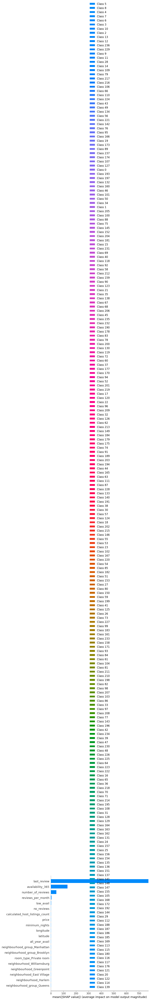

In [35]:
shap.summary_plot(shap_values, X_test, feature_names=X_train.columns)

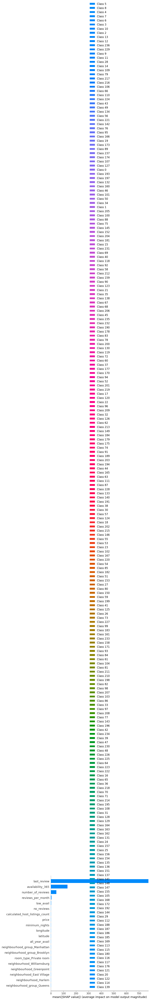

In [38]:
shap.summary_plot(shap_values, X_train, feature_names=X_train.columns, plot_type="bar")

1001
1002


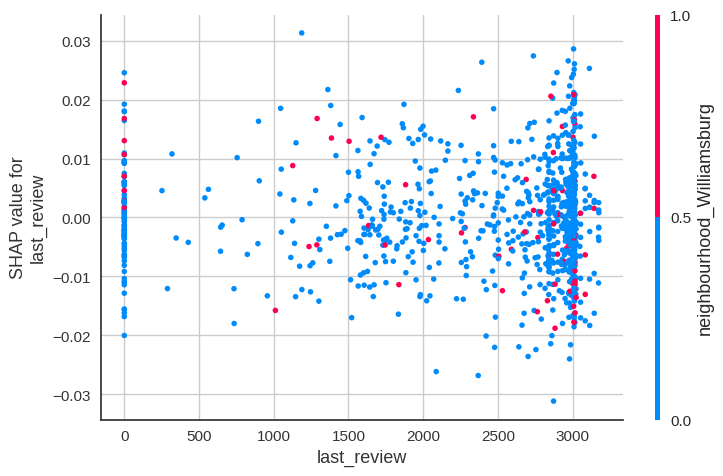

In [61]:
shap.dependence_plot("last_review", shap_values[0], features=X_train[:1001], feature_names=X_train.columns)

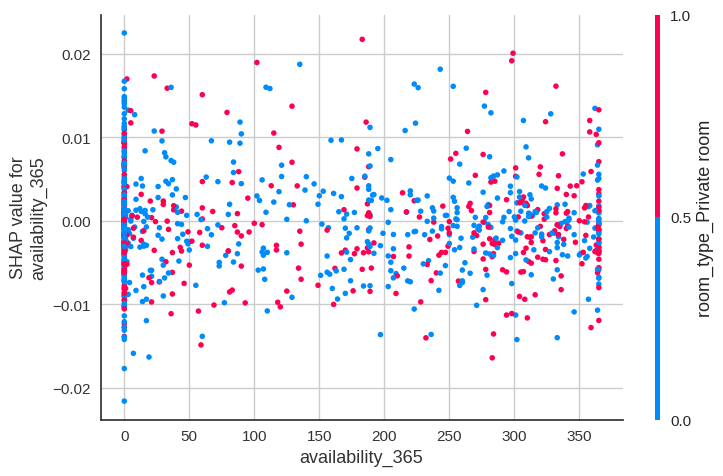

In [62]:
shap.dependence_plot("availability_365", shap_values[0], features=X_train[:1001], feature_names=X_train.columns)

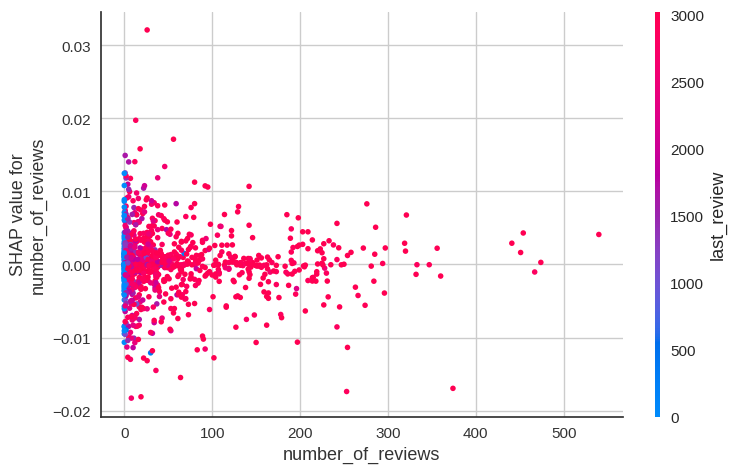

In [64]:
shap.dependence_plot("number_of_reviews", shap_values[0], features=X_train[:1001], feature_names=X_train.columns)